# ENTRENAMIENTO Y EVALUACIÓN DEL MODELO SEGFORMER

En el presente notebook se recogen los trabajos realizados para entregar el modelo con la arquitectura Segformer para la identificación de edificios a través de imágenes satelitales y su posterior evaluación para comprobar su desempeño.

# ENTRENAMIENTO

## Configuración

Instalación de la librería "transformers" necesaria para este proyecto, y posteriormente se importan el resto de librerias que se usan en la fase de entrenamiento.

In [ ]:
!pip install transformers==4.27.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 27.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.2/311.2 kB 33.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 80.6 MB/s eta 0:00:00


In [ ]:
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torch.optim import AdamW
from transformers import SegformerForSemanticSegmentation, SegformerImageProcessor
import albumentations as aug

import torch.nn.functional as F
from torch.utils.tensorboard import SummaryWriter
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import f1_score, accuracy_score, jaccard_score

import cv2
from PIL import Image
from tqdm.notebook import tqdm

import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from google.colab import files, drive

In [ ]:
# Establezco una ruta absoluta a un directorio existente de mi Google Drive
DRIVE_DIR = "/content/drive/MyDrive/TFM/dataset/"

AUX_DIR = "/content"
ROOT_DIR = "/content/dataset"

IMAGES_DIR = os.path.join(ROOT_DIR, 'Processed Images Mix')
MASKS_DIR = os.path.join(ROOT_DIR, 'Processed Masks Mix')

# Conectamos con nuestro Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


ES DEMASIADO PESADA LA CARPETA

Para evitar interrupciones de conexión entre Google Colab y Drive vamos a copiar las imágenes de entrenamiento al entorno local:

In [ ]:
import shutil

# Copiar todo el contenido de la carpeta de Drive a la carpeta local
shutil.copytree(os.path.join(DRIVE_DIR, "Processed Images Mix"), IMAGES_DIR)
shutil.copytree(os.path.join(DRIVE_DIR, "Processed Masks Mix"), MASKS_DIR)

'/content/dataset/Processed Masks Mix'

In [ ]:
def copy_files_from_temp(src_dir, dst_dir):
    # Copiar cada archivo del directorio fuente al directorio destino
    for filename in os.listdir(src_dir):
        src_file = os.path.join(src_dir, filename)
        dst_file = os.path.join(dst_dir, filename)
        if os.path.isfile(src_file):
            shutil.copy(src_file, dst_file)

# Rutas temporales
temp_images_path = "/content/dataset/ruta1"
temp_masks_path = "/content/dataset/ruta2"

# Copiar los directorios "Images Cairo" y "Masks Cairo" a las rutas temporales
shutil.copytree(os.path.join(DRIVE_DIR, "Images Macha"), temp_images_path)
shutil.copytree(os.path.join(DRIVE_DIR, "Mask Macha"), temp_masks_path)

# Mover los archivos de las rutas temporales a los directorios finales
copy_files_from_temp(temp_images_path, IMAGES_DIR)
copy_files_from_temp(temp_masks_path, MASKS_DIR)

# Opcionalmente, eliminar los directorios temporales si ya no se necesitan
shutil.rmtree(temp_images_path)
shutil.rmtree(temp_masks_path)

## Definir Clases

Debemos crear una clase que sea hija de la clase Dataset. Esta clase nos sirve para importar las imágenes al proyecto y construir nuestra propio conjunto de datos.

In [ ]:
class ImageSegmentationDataset(Dataset):
    """Image segmentation dataset."""
    # Constructor
    def __init__(self, img_dir, mask_dir, feature_extractor, transforms=None, train=True):
        """
        Args:
            root_dir (string): Root directory of the dataset containing the images + annotations.
            feature_extractor (SegFormerFeatureExtractor): feature extractor to prepare images + segmentation maps.
            train (bool): Whether to load "training" or "validation" images + annotations.
        """
        self.img_dir = img_dir
        self.mask_dir = mask_dir
        self.feature_extractor = feature_extractor
        self.train = train
        self.transforms = transforms

        images = sorted(os.listdir(self.img_dir)) # read images
        masks = sorted(os.listdir(self.mask_dir)) # read masks

        # Split into train and test set
        train_images, test_images, train_masks, test_masks = train_test_split(images, masks, test_size=0.1, random_state=42)
        if self.train:
            self.images = train_images
            self.masks = train_masks
        else:
            self.images = test_images
            self.masks = test_masks

        assert len(self.images) == len(self.masks), "There must be as many images as there are segmentation maps"

    # Métodos
    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        try:
            image = cv2.imread(os.path.join(self.img_dir, self.images[idx]))
            if image is None:
                raise ValueError(f"Error al leer la imagen: {self.images[idx]}")

            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = (image / 255).astype(np.float32)

            segmentation_map = cv2.imread(os.path.join(self.mask_dir, self.masks[idx]))
            if segmentation_map is None:
                raise ValueError(f"Error al leer la máscara: {self.masks[idx]}")

            segmentation_map = cv2.cvtColor(segmentation_map, cv2.COLOR_BGR2GRAY)
            segmentation_map = segmentation_map/255  # Escalar a [0,1]

            if self.transforms is not None:
                augmented = self.transforms(image=image, mask=segmentation_map)
                encoded_inputs = self.feature_extractor(augmented['image'], augmented['mask'], return_tensors="pt")
            else:
                encoded_inputs = self.feature_extractor(image, segmentation_map, return_tensors="pt")

            for k,v in encoded_inputs.items():
                encoded_inputs[k].squeeze_() # remove batch dimension

            return encoded_inputs
        except Exception as e:
            print(f"Error en idx={idx}: {e}")
            return None

In [ ]:
# Data Augmentation
transforms = aug.Compose([
    aug.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2, always_apply=False, p=0.5), # Variar luminosidad de la escena
    aug.Rotate(limit=360, p=0.5),  # Giro completo en cualquier dirección
    # aug.GaussNoise(p=0.3),  # Introduce ruido gaussiano - probabilidad 30%
])

## Inicializaciones

En esta sección visualizamos alguna imagen del dataset como ejemplo, así como su máscara y comprobamos que todo funciona correctamente.
Finalmente descargamos un modelo preentrenado de Segformer.

In [ ]:
feature_extractor = SegformerImageProcessor(align=False, reduce_zero_label=False)
feature_extractor.size = 512 # Las imágenes tienen dimension de 1000x1000

train_dataset = ImageSegmentationDataset(img_dir=IMAGES_DIR, mask_dir=MASKS_DIR, feature_extractor=feature_extractor, transforms=transforms)
test_dataset = ImageSegmentationDataset(img_dir=IMAGES_DIR, mask_dir=MASKS_DIR, feature_extractor=feature_extractor, transforms=None, train=False)

In [ ]:
print("Número de muestras de entrenamiento:", len(train_dataset))
print("Número de muestras de test:", len(test_dataset))

Número de muestras de entrenamiento: 5453
Número de muestras de test: 606


In [ ]:
encoded_inputs = train_dataset[0]

In [ ]:
encoded_inputs["pixel_values"].shape

torch.Size([3, 512, 512])

In [ ]:
encoded_inputs["labels"].shape

torch.Size([512, 512])

In [ ]:
encoded_inputs["labels"]

tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]])

In [ ]:
encoded_inputs["labels"].squeeze().unique()

tensor([0, 1])

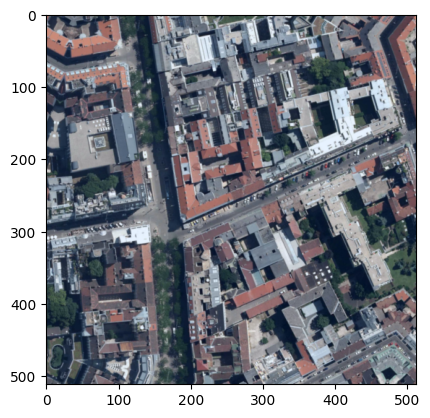

In [ ]:
img = encoded_inputs["pixel_values"].numpy().squeeze()
img = img - np.min(img)
img = img / np.max(img)
plt.imshow(np.transpose(img, (1, 2, 0)))  # Reordenar los ejes, porque espera (alto, ancho, canales)

plt.show()

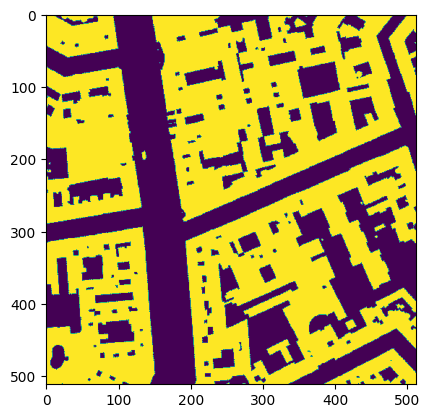

In [ ]:
mask = encoded_inputs["labels"].numpy()
plt.imshow(mask)

In [ ]:
train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8)

In [ ]:
batch = next(iter(train_dataloader))

In [ ]:
for k,v in batch.items():
    print(k, v.shape)

pixel_values torch.Size([8, 3, 512, 512])
labels torch.Size([8, 512, 512])


In [ ]:
batch["labels"].shape

torch.Size([8, 512, 512])

In [ ]:
classes = pd.read_csv(os.path.join(ROOT_DIR, 'class_dict.csv'))['name']
id2label = classes.to_dict()
label2id = {v: k for k, v in id2label.items()}

In [ ]:
model = SegformerForSemanticSegmentation.from_pretrained("nvidia/mit-b5",
                                                         ignore_mismatched_sizes=True,
                                                         num_labels=len(id2label),
                                                         id2label=id2label,
                                                         label2id=label2id,
                                                         reshape_last_stage=True)

(…)o/nvidia/mit-b5/resolve/main/config.json:   0%|          | 0.00/70.0k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/328M [00:00<?, ?B/s]

Some weights of the model checkpoint at nvidia/mit-b5 were not used when initializing SegformerForSemanticSegmentation: ['classifier.weight', 'classifier.bias']
- This IS expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/mit-b5 and are newly initialized: ['decode_head.linear_c.1.proj.weight', 'decode_head.linear_c.1.proj.bias', 'decode_head.classifier.weight', 'decode_head.linear_c.3.proj.weight', 'decode_head.linear_c.0.proj.bias', 'decode_head.linea

In [ ]:
optimizer = AdamW(model.parameters(), lr=0.00006)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

print("Model Initialized!")

Model Initialized!


## Métodos para el entrenamiento

En estos métodos se define el bucle de entrenamiento. Se divide en diferentes métodos para que sea más fácil de mantener y de replicar en distintos entrenamientos, así como editar para cambiar en distintas pruebas.

In [ ]:
def train_one_epoch(model, dataloader, optimizer, device):
    model.train()
    accuracies, losses, iou_scores, f1_scores = [], [], [], []

    pbar = tqdm(dataloader, desc="Training")  # Barra de progreso
    for idx, batch in enumerate(pbar):
        # get the inputs
        pixel_values = batch["pixel_values"].to(device)
        labels = batch["labels"].to(device)

        optimizer.zero_grad() # zero the parameter gradients
        outputs = model(pixel_values=pixel_values, labels=labels) # forward

        upsampled_logits = F.interpolate(outputs.logits, size=labels.shape[-2:], mode="bilinear", align_corners=False)
        predicted = upsampled_logits.argmax(dim=1)

        pred_labels = predicted.detach().cpu().numpy().flatten()
        true_labels = labels.detach().cpu().numpy().flatten()

        accuracy = accuracy_score(true_labels, pred_labels)
        loss = outputs.loss.item()
        iou_val = jaccard_score(true_labels, pred_labels, average='binary', zero_division=np.nan)
        f1_val = f1_score(true_labels, pred_labels, average='binary', zero_division=1.0)

        accuracies.append(accuracy)
        losses.append(loss)
        iou_scores.append(iou_val)
        f1_scores.append(f1_val)

        outputs.loss.backward()
        optimizer.step()

        # Actualizar la barra de progreso con las métricas actuales
        pbar.set_postfix({
            'Loss': loss,
            'Accuracy': accuracy,
            'IoU': iou_val,
            'F1 Score': f1_val
        })

    return {
        "accuracy": sum(accuracies)/len(accuracies),
        "loss": sum(losses)/len(losses),
        "iou": sum(iou_scores)/len(iou_scores),
        "f1": sum(f1_scores)/len(f1_scores)
    }

In [ ]:
def validate_one_epoch(model, dataloader, device):
    model.eval()
    accuracies, losses, iou_scores, f1_scores = [], [], [], []

    with torch.no_grad():
        for idx, batch in enumerate(dataloader):
            pixel_values = batch["pixel_values"].to(device)
            labels = batch["labels"].to(device)

            outputs = model(pixel_values=pixel_values, labels=labels)

            upsampled_logits = F.interpolate(outputs.logits, size=labels.shape[-2:], mode="bilinear", align_corners=False)
            predicted = upsampled_logits.argmax(dim=1)

            pred_labels = predicted.detach().cpu().numpy().flatten()
            true_labels = labels.detach().cpu().numpy().flatten()

            accuracy = accuracy_score(true_labels, pred_labels)
            val_loss = outputs.loss.item()
            iou_val = jaccard_score(true_labels, pred_labels, average='binary', zero_division=np.nan)
            f1_val = f1_score(true_labels, pred_labels, average='binary', zero_division=1.0)

            accuracies.append(accuracy)
            losses.append(val_loss)
            iou_scores.append(iou_val)
            f1_scores.append(f1_val)

    return {
        "accuracy": sum(accuracies)/len(accuracies),
        "loss": sum(losses)/len(losses),
        "iou": sum(iou_scores)/len(iou_scores),
        "f1": sum(f1_scores)/len(f1_scores)
    }

In [ ]:
def training(model, optimizer, device, epochs=11, batch_size=32, k_folds=5, patience=5):
    # Configuración de TensorBoard
    writer = SummaryWriter(os.path.join(AUX_DIR, 'tensorboard_logs/'))

    # Configuración de los callbacks
    best_val_loss = float('inf')
    patience_counter = 0

    # Inicializamos el k-fold cross validation
    kf = KFold(n_splits=k_folds, shuffle=True)

    try:
        for fold, (train_idx, valid_idx) in enumerate(kf.split(train_dataset)): # Loop through each fold
            # Define the data loaders for the current fold
            train_dataloader = DataLoader(
                dataset=train_dataset,
                batch_size=batch_size,
                sampler=torch.utils.data.SubsetRandomSampler(train_idx),
            )
            valid_dataloader = DataLoader(
                dataset=train_dataset,
                batch_size=batch_size,
                sampler=torch.utils.data.SubsetRandomSampler(valid_idx),
            )

            for epoch in range(1, epochs):  # loop over the dataset multiple times
                print(f"Fold: {fold + 1} -- Epoch: {epoch}")

                # Entrenamiento
                train_metrics = train_one_epoch(model, train_dataloader, optimizer, device)
                print(f"Train Pixel-wise accuracy: {train_metrics['accuracy']}\
                      Train Loss: {train_metrics['loss']}\
                      Train IoU: {train_metrics['iou']}\
                      Train F1: {train_metrics['f1']}")

                # Escritura en TensorBoard
                writer.add_scalar(f'Fold_{fold+1}/Loss/train', train_metrics['loss'], epoch)
                writer.add_scalar(f'Fold_{fold+1}/Accuracy/train', train_metrics['accuracy'], epoch)
                writer.add_scalar(f'Fold_{fold+1}/IoU/train', train_metrics['iou'], epoch)
                writer.add_scalar(f'Fold_{fold+1}/F1/train', train_metrics['f1'], epoch)
                writer.flush()

                # Validación (este código se mantiene similar al proporcionado anteriormente)
                valid_metrics = validate_one_epoch(model, valid_dataloader, device)
                # Impresión de métricas de validación
                print(f"Val Pixel-wise accuracy: {valid_metrics['accuracy']}\
                      Val Loss: {valid_metrics['loss']}\
                      Val IoU: {valid_metrics['iou']}\
                      Val F1: {valid_metrics['f1']}")

                # Escritura en TensorBoard
                writer.add_scalar(f'Fold_{fold+1}/Loss/val', valid_metrics['loss'], epoch)
                writer.add_scalar(f'Fold_{fold+1}/Accuracy/val', valid_metrics['accuracy'], epoch)
                writer.add_scalar(f'Fold_{fold+1}/IoU/val', valid_metrics['iou'], epoch)
                writer.add_scalar(f'Fold_{fold+1}/F1/val', valid_metrics['f1'], epoch)
                writer.flush()

                # Callbacks
                if valid_metrics['loss'] < best_val_loss:
                    best_val_loss = valid_metrics['loss']
                    torch.save({
                        'epoch': epoch,
                        'model_state_dict': model.state_dict(),
                        'optimizer_state_dict': optimizer.state_dict(),
                        'loss': valid_metrics['loss'],
                        'accuracy': valid_metrics['accuracy'],
                        'iou': valid_metrics['iou'],
                        'f1': valid_metrics['f1']
                    }, os.path.join(AUX_DIR, f'best_model_checkpoint_{fold + 1}_{epoch}.pth'))
                    patience_counter = 0
                else:
                    patience_counter += 1

                if patience_counter >= patience:
                    print(">> Early stopping triggered.")
                    return # Exit

        writer.close() # End k_fold loop

    except Exception as e:
        print(f"Error occurred during training/validation in Fold {fold + 1}, Epoch {epoch}.")
        print(f"Error: {e}")
        writer.close()
        return # Terminate the training if an error is encountered

## Entrenamiento (Fase I)

In [ ]:
# Definimos los hiperparámetros del entrenamiento
EPOCHS = 6
BATCH_SIZE = 4
K_FOLDS = 5
PATIENCE = 10

training(model, optimizer, device, EPOCHS, BATCH_SIZE, K_FOLDS, PATIENCE)

Fold: 1 -- Epoch: 1


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9553802387087199                      Train Loss: 0.11294709390676372                      Train IoU: 0.6628465194522174                      Train F1: 0.7832716384602054
Val Pixel-wise accuracy: 0.9592114473000551                      Val Loss: 0.10253653633015933                      Val IoU: 0.6801878882057474                      Val F1: 0.7930574752318934
Fold: 1 -- Epoch: 2


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9620506214942548                      Train Loss: 0.09289038764982117                      Train IoU: 0.7029185287299672                      Train F1: 0.8141051147484304
Val Pixel-wise accuracy: 0.961882832286122                      Val Loss: 0.09348971328455886                      Val IoU: 0.7053761480408703                      Val F1: 0.8156993528045716
Fold: 1 -- Epoch: 3


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9639573477474951                      Train Loss: 0.08735486153085519                      Train IoU: 0.7150555625181847                      Train F1: 0.822085413811802
Val Pixel-wise accuracy: 0.9627561254815741                      Val Loss: 0.0908290816602321                      Val IoU: 0.7068004159376257                      Val F1: 0.8138129225297723
Fold: 1 -- Epoch: 4


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9646079354500355                      Train Loss: 0.08547066299754386                      Train IoU: 0.7202469359455727                      Train F1: 0.8260454494975459
Val Pixel-wise accuracy: 0.9632006005926447                      Val Loss: 0.08969385054767569                      Val IoU: 0.718536428491099                      Val F1: 0.8255680747415983
Fold: 1 -- Epoch: 5


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9652896351381577                      Train Loss: 0.0837704177449033                      Train IoU: 0.7247281442614808                      Train F1: 0.8285278812866409
Val Pixel-wise accuracy: 0.9631014638768011                      Val Loss: 0.09012949693907094                      Val IoU: 0.7218086192897739                      Val F1: 0.8284456068629933
Fold: 2 -- Epoch: 1


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9643077998943661                      Train Loss: 0.0864034443427864                      Train IoU: 0.7188292639566807                      Train F1: 0.8255066429381755
Val Pixel-wise accuracy: 0.9656104657239529                      Val Loss: 0.08286836168698065                      Val IoU: 0.7175922362650715                      Val F1: 0.8234465086170017
Fold: 2 -- Epoch: 2


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9648651469201805                      Train Loss: 0.08493086614660529                      Train IoU: 0.7177357472509744                      Train F1: 0.8228849990213523
Val Pixel-wise accuracy: 0.965875506837726                      Val Loss: 0.08191289597842501                      Val IoU: 0.7209665580879441                      Val F1: 0.8258971085250245
Fold: 2 -- Epoch: 3


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9657840195541312                      Train Loss: 0.08214546155412217                      Train IoU: 0.7296747028635938                      Train F1: 0.8327035306532717
Val Pixel-wise accuracy: 0.9651301958039857                      Val Loss: 0.08523794013542897                      Val IoU: 0.7109384613590818                      Val F1: 0.8182186284994417
Fold: 2 -- Epoch: 4


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9656577184591459                      Train Loss: 0.08235666977103345                      Train IoU: 0.7309682240282723                      Train F1: 0.8342267477611731
Val Pixel-wise accuracy: 0.9667048681349981                      Val Loss: 0.07997794082002789                      Val IoU: 0.7296373934004055                      Val F1: 0.8333870867814092
Fold: 2 -- Epoch: 5


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9661442138643903                      Train Loss: 0.08119121100155997                      Train IoU: 0.7337699279716564                      Train F1: 0.8354161464219507
Val Pixel-wise accuracy: 0.96600095867674                      Val Loss: 0.08172715045238807                      Val IoU: 0.7260984220734714                      Val F1: 0.8310473604385814
Fold: 3 -- Epoch: 1


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9658863572873291                      Train Loss: 0.08177682396287388                      Train IoU: 0.7287955110065207                      Train F1: 0.8315149913003902
Val Pixel-wise accuracy: 0.967480476668175                      Val Loss: 0.07730916853108863                      Val IoU: 0.7340054029877959                      Val F1: 0.8350856378527629
Fold: 3 -- Epoch: 2


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9660521908488217                      Train Loss: 0.08147163210841328                      Train IoU: 0.7299829817336669                      Train F1: 0.8330704929147028
Val Pixel-wise accuracy: 0.9674574801918934                      Val Loss: 0.07744623410034475                      Val IoU: 0.7292425903574853                      Val F1: 0.8299830241123547
Fold: 3 -- Epoch: 3


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9665293662947979                      Train Loss: 0.0802535324457326                      Train IoU: 0.73344661220759                      Train F1: 0.8346802948692803
Val Pixel-wise accuracy: 0.9677043409429044                      Val Loss: 0.07699965138837778                      Val IoU: 0.7394835030486016                      Val F1: 0.8394604751254804
Fold: 3 -- Epoch: 4


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9668229773545025                      Train Loss: 0.07932246554274569                      Train IoU: 0.7358321583541885                      Train F1: 0.8362798061901846
Val Pixel-wise accuracy: 0.96770447368878                      Val Loss: 0.07675788258697032                      Val IoU: 0.7397971428348247                      Val F1: 0.8403246386154192
Fold: 3 -- Epoch: 5


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9669982864701562                      Train Loss: 0.07880576122910686                      Train IoU: 0.7353666760891305                      Train F1: 0.8351505113058488
Val Pixel-wise accuracy: 0.9676794639000525                      Val Loss: 0.07690881184155579                      Val IoU: 0.7428384732880791                      Val F1: 0.8429139978308227
Fold: 4 -- Epoch: 1


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.966379587853534                      Train Loss: 0.08074658012741495                      Train IoU: 0.7295307250486934                      Train F1: 0.831723959129261
Val Pixel-wise accuracy: 0.9682291890238668                      Val Loss: 0.07516117427743725                      Val IoU: 0.7419614857049095                      Val F1: 0.8405046221058283
Fold: 4 -- Epoch: 2


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9671371313107331                      Train Loss: 0.07845072027835329                      Train IoU: 0.7338993958766096                      Train F1: 0.834350753237105
Val Pixel-wise accuracy: 0.968457777421553                      Val Loss: 0.07501142188197091                      Val IoU: 0.7519874195778988                      Val F1: 0.8489466964353581
Fold: 4 -- Epoch: 3


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9670162871093004                      Train Loss: 0.07879837774214916                      Train IoU: 0.7392815140127705                      Train F1: 0.8394486110500028
Val Pixel-wise accuracy: 0.9679782539060264                      Val Loss: 0.07596591741679025                      Val IoU: 0.7469189241569131                      Val F1: 0.8452021241402369
Fold: 4 -- Epoch: 4


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9672037125216543                      Train Loss: 0.07835233848461733                      Train IoU: 0.7335427478930908                      Train F1: 0.8338952740744632
Val Pixel-wise accuracy: 0.9686644068567745                      Val Loss: 0.07423499573129587                      Val IoU: 0.7434550016186859                      Val F1: 0.8412519359694265
Fold: 4 -- Epoch: 5


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9676081555136621                      Train Loss: 0.07712243560285031                      Train IoU: 0.7398867960902388                      Train F1: 0.8393402415551574
Val Pixel-wise accuracy: 0.9685306060008514                      Val Loss: 0.07470442166026586                      Val IoU: 0.742687748378981                      Val F1: 0.8409243147053181
Fold: 5 -- Epoch: 1


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9676754121346244                      Train Loss: 0.07696002593911044                      Train IoU: 0.7417808313907048                      Train F1: 0.8402399002121077
Val Pixel-wise accuracy: 0.9685505842551206                      Val Loss: 0.0750352652340909                      Val IoU: 0.7454215787607502                      Val F1: 0.842222797493426
Fold: 5 -- Epoch: 2


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9676998271295284                      Train Loss: 0.07674145431037545                      Train IoU: 0.7332477963918707                      Train F1: 0.8329891888149248
Val Pixel-wise accuracy: 0.9681040411030416                      Val Loss: 0.0759069928592378                      Val IoU: 0.7386608613694065                      Val F1: 0.8371863266304921
Fold: 5 -- Epoch: 3


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9679085349512144                      Train Loss: 0.0762515926550507                      Train IoU: 0.7447215299397244                      Train F1: 0.8433882275800264
Val Pixel-wise accuracy: 0.9681895294468919                      Val Loss: 0.07578764850744507                      Val IoU: 0.7448285161123028                      Val F1: 0.842101078516415
Fold: 5 -- Epoch: 4


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.967913967660542                      Train Loss: 0.07627725228581896                      Train IoU: 0.7458076731229829                      Train F1: 0.8441540507139638
Val Pixel-wise accuracy: 0.9680115486676003                      Val Loss: 0.07639203301798074                      Val IoU: 0.7536787642547716                      Val F1: 0.8527450017720147
Fold: 5 -- Epoch: 5


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9682794102389916                      Train Loss: 0.0753194390434181                      Train IoU: 0.7442260261080544                      Train F1: 0.8424771151659476
Val Pixel-wise accuracy: 0.9682682582310268                      Val Loss: 0.07560480447083494                      Val IoU: 0.7466360000907188                      Val F1: 0.8438373045591229


In [ ]:
%load_ext tensorboard
%tensorboard --logdir="$AUX_DIR/tensorboard_logs/"

<IPython.core.display.Javascript object>

## Entrenamiento (Fase II)

Continuamos con el entrenamiento para tratar de mejorar el modelo

In [ ]:
# checkpoint = torch.load(os.path.join(AUX_DIR, f'best_model_checkpoint_{fold}_{epoch}.pth'))
checkpoint = torch.load(os.path.join(AUX_DIR, f'/content/drive/MyDrive/TFM/auxiliar/best_model_checkpoint_V._4_4.pth'))
model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
current_epoch = checkpoint['epoch']
valid_loss = checkpoint['loss']
valid_accuracy = checkpoint['accuracy']
valid_iou = checkpoint['iou']
valid_f1 = checkpoint['f1']

# Define the number of folds and batch size
EPOCHS = 7
BATCH_SIZE = 4
K_FOLDS = 5
PATIENCE = 10

training(model, optimizer, device, EPOCHS, BATCH_SIZE, K_FOLDS, PATIENCE)

Fold: 1 -- Epoch: 1


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9671136198734385                      Train Loss: 0.07840139297356592                      Train IoU: 0.7405593274239044                      Train F1: 0.8407616764502862
Val Pixel-wise accuracy: 0.9689436936989809                      Val Loss: 0.07369750650811108                      Val IoU: 0.7401614962290474                      Val F1: 0.8395161539505397
Fold: 1 -- Epoch: 2


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9678849291080297                      Train Loss: 0.07637737677936245                      Train IoU: 0.7455629391238172                      Train F1: 0.8434359610408299
Val Pixel-wise accuracy: 0.9689160674191802                      Val Loss: 0.07364353341572397                      Val IoU: 0.7411064604876527                      Val F1: 0.8410726774433432
Fold: 1 -- Epoch: 3


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.967455594721024                      Train Loss: 0.07746683354716788                      Train IoU: 0.7426208710046555                      Train F1: 0.8418378790981845
Val Pixel-wise accuracy: 0.9683296846382784                      Val Loss: 0.07507244572077533                      Val IoU: 0.7497540601367736                      Val F1: 0.8480453357128217
Fold: 1 -- Epoch: 4


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9680760616998296                      Train Loss: 0.0759454134661332                      Train IoU: 0.7432465297716254                      Train F1: 0.8408438575494636
Val Pixel-wise accuracy: 0.9683418565035157                      Val Loss: 0.07525871185101432                      Val IoU: 0.7392339398464907                      Val F1: 0.8389195828767345
Fold: 1 -- Epoch: 5


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9675393764520325                      Train Loss: 0.07735094282665998                      Train IoU: 0.7425930958630585                      Train F1: 0.8413943505339153
Val Pixel-wise accuracy: 0.9682336080641973                      Val Loss: 0.07541978623608857                      Val IoU: 0.7388758342504752                      Val F1: 0.8396697897564044
Fold: 1 -- Epoch: 6


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9680650310708666                      Train Loss: 0.07591091008444158                      Train IoU: 0.7444221967986107                      Train F1: 0.8421757743666435
Val Pixel-wise accuracy: 0.9680373793847685                      Val Loss: 0.07624619512139877                      Val IoU: 0.7386320624800515                      Val F1: 0.8392389482401148
Fold: 2 -- Epoch: 1


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.967637535850462                      Train Loss: 0.07702301134074518                      Train IoU: 0.7435581630369147                      Train F1: 0.8423232393945058
Val Pixel-wise accuracy: 0.9702247857174158                      Val Loss: 0.07038680235121822                      Val IoU: 0.7517802988063332                      Val F1: 0.8466308774641675
Fold: 2 -- Epoch: 2


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9680517355746681                      Train Loss: 0.07595410147266962                      Train IoU: 0.74226462550707                      Train F1: 0.8410242788890206
Val Pixel-wise accuracy: 0.9703009725344777                      Val Loss: 0.07022410765846325                      Val IoU: 0.7482358240988863                      Val F1: 0.8424807212456015
Fold: 2 -- Epoch: 3


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9680481735005715                      Train Loss: 0.07583728776459338                      Train IoU: 0.7421131298207794                      Train F1: 0.840460012547317
Val Pixel-wise accuracy: 0.9698730266137874                      Val Loss: 0.07117001620085481                      Val IoU: 0.7484544993596481                      Val F1: 0.8441357902885485
Fold: 2 -- Epoch: 4


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9682784696766042                      Train Loss: 0.07523493609249449                      Train IoU: 0.7450526132544605                      Train F1: 0.8423771891012821
Val Pixel-wise accuracy: 0.9701715301681351                      Val Loss: 0.07060339042555282                      Val IoU: 0.759140847024212                      Val F1: 0.8522117578957794
Fold: 2 -- Epoch: 5


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9674664409088498                      Train Loss: 0.0781304014955095                      Train IoU: 0.745276430977749                      Train F1: 0.8434436705541036
Val Pixel-wise accuracy: 0.9700327932616293                      Val Loss: 0.07089356494378367                      Val IoU: 0.7423973209057299                      Val F1: 0.8373320788341828
Fold: 2 -- Epoch: 6


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9683220537292313                      Train Loss: 0.07522365260881216                      Train IoU: 0.7449115070488876                      Train F1: 0.8428676849895212
Val Pixel-wise accuracy: 0.969763437906901                      Val Loss: 0.07176418298081028                      Val IoU: 0.7476147656814692                      Val F1: 0.8444809679925679
Fold: 3 -- Epoch: 1


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9688685668050204                      Train Loss: 0.07375640403603116                      Train IoU: 0.7472758677409795                      Train F1: 0.8445733955802728
Val Pixel-wise accuracy: 0.9687234298650161                      Val Loss: 0.07435198411713917                      Val IoU: 0.7450505717435248                      Val F1: 0.8392378656487075
Fold: 3 -- Epoch: 2


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9686216088635019                      Train Loss: 0.07466744484958657                      Train IoU: 0.7448100638489229                      Train F1: 0.8431171565929839
Val Pixel-wise accuracy: 0.9665553042885731                      Val Loss: 0.08012156387374843                      Val IoU: 0.736310409474331                      Val F1: 0.8351596615391664
Fold: 3 -- Epoch: 3


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9687176878358332                      Train Loss: 0.07407543535611492                      Train IoU: 0.7433486500454529                      Train F1: 0.8413589994528382
Val Pixel-wise accuracy: 0.968327766809708                      Val Loss: 0.0753964618250946                      Val IoU: 0.7513307512950429                      Val F1: 0.8465607939206077
Fold: 3 -- Epoch: 4


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9688116409273786                      Train Loss: 0.074218315916182                      Train IoU: 0.7482687852952                      Train F1: 0.8459157994213437
Val Pixel-wise accuracy: 0.9680677059951429                      Val Loss: 0.0763349552679766                      Val IoU: 0.7499023163298032                      Val F1: 0.8483182069752047
Fold: 3 -- Epoch: 5


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9693009414113409                      Train Loss: 0.07264562411187686                      Train IoU: 0.7487721283493883                      Train F1: 0.8454447841684881
Val Pixel-wise accuracy: 0.9686676824194754                      Val Loss: 0.07451284465707511                      Val IoU: 0.7622962581927575                      Val F1: 0.8566239264176818
Fold: 3 -- Epoch: 6


Training:   0%|          | 0/1091 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9692291273751683                      Train Loss: 0.07271492748037253                      Train IoU: 0.7473976737498771                      Train F1: 0.8443417501152441
Val Pixel-wise accuracy: 0.9685748977102203                      Val Loss: 0.07465726170593347                      Val IoU: 0.7564754609280453                      Val F1: 0.8522842485801184
>> Early stopping triggered.


In [ ]:
%load_ext tensorboard
%tensorboard --logdir="$AUX_DIR/tensorboard_logs/"

<IPython.core.display.Javascript object>

# EVALUACIÓN

## Configuración

Instalación de la librería "transformers" necesaria para este proyecto, y posteriormente se importan el resto de librerias que se usan en la fase de evaluación.

In [ ]:
!pip install transformers==4.27.1

In [ ]:
import os
import cv2
import torch
from torch.utils.data import Dataset, DataLoader
from torch import nn
from torch.optim import AdamW
from transformers import SegformerForSemanticSegmentation, SegformerImageProcessor

from sklearn.metrics import accuracy_score, f1_score, jaccard_score
from sklearn.model_selection import train_test_split
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt

from google.colab import files, drive

In [ ]:
# Establezco una ruta absoluta a un directorio existente de mi Google Drive
ROOT_DIR = "/content/drive/MyDrive/TFM/dataset/"
AUX_DIR = "/content/drive/MyDrive/TFM/auxiliar"

IMAGES_DIR = os.path.join(ROOT_DIR, 'Processed Images Mix')
MASKS_DIR = os.path.join(ROOT_DIR, 'Processed Masks Mix')

# Conectamos con nuestro Google Drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Cargar Datos

Vamos a cargar los pesos y estado del último modelo entrenado.

In [ ]:
df = pd.read_csv(os.path.join(ROOT_DIR, 'class_dict.csv'))

classes = df['name']
palette = df[[' r', ' g', ' b']].values
id2label = classes.to_dict()
label2id = {v: k for k, v in id2label.items()}

In [ ]:
feature_extractor = SegformerImageProcessor(align=False, reduce_zero_label=False)
feature_extractor.size = 512

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = SegformerForSemanticSegmentation.from_pretrained("nvidia/mit-b5",
                                                         ignore_mismatched_sizes=True,
                                                         num_labels=len(id2label),
                                                         id2label=id2label,
                                                         label2id=label2id,
                                                         reshape_last_stage=True)

if torch.cuda.is_available():
    checkpoint = torch.load(os.path.join(AUX_DIR, 'best_model_checkpoint_VI_2_2.pth'))
    model.load_state_dict(checkpoint['model_state_dict'])
else:
    checkpoint = torch.load(os.path.join(AUX_DIR, 'best_model_checkpoint_VI_2_2.pth'), map_location=torch.device('cpu'))
    model.load_state_dict(checkpoint['model_state_dict'])

optimizer = AdamW(model.parameters(), lr=0.00006)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

Some weights of the model checkpoint at nvidia/mit-b5 were not used when initializing SegformerForSemanticSegmentation: ['classifier.weight', 'classifier.bias']
- This IS expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/mit-b5 and are newly initialized: ['decode_head.linear_c.1.proj.weight', 'decode_head.linear_c.1.proj.bias', 'decode_head.classifier.weight', 'decode_head.linear_c.3.proj.weight', 'decode_head.linear_c.0.proj.bias', 'decode_head.linea

SegformerForSemanticSegmentation(
  (segformer): SegformerModel(
    (encoder): SegformerEncoder(
      (patch_embeddings): ModuleList(
        (0): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(3, 64, kernel_size=(7, 7), stride=(4, 4), padding=(3, 3))
          (layer_norm): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        )
        (1): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        )
        (2): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(128, 320, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((320,), eps=1e-05, elementwise_affine=True)
        )
        (3): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(320, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)

## Evaluar en el conjunto de test

Visualizamos una imagen del conjunto de test y definimos el bucle en este caso para evaluar el modelo entrenado con anterioridad.

In [ ]:
test_dataset = ImageSegmentationDataset(img_dir=IMAGES_DIR, mask_dir=MASKS_DIR, feature_extractor=feature_extractor, transforms=None, train=False)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=4, shuffle=False)

print("Número de muestras de test:", len(test_dataset))

Número de muestras de test: 591


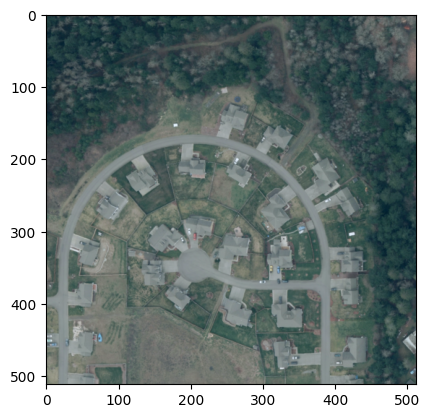

In [ ]:
encoded_inputs = test_dataset[0]
img = encoded_inputs["pixel_values"].numpy().squeeze()
img = img - np.min(img)
img = img / np.max(img)
plt.imshow(np.transpose(img, (1, 2, 0)))  # Reordenar los ejes, porque espera (alto, ancho, canales)

plt.show()

In [ ]:
accuracies, losses, iou_scores, f1_scores = [], [], [], []

with torch.no_grad(): # No necesitamos gradientes en evaluación
    for idx, batch in enumerate(test_dataloader):
        pixel_values = batch["pixel_values"].to(device)
        labels = batch["labels"].to(device)

        outputs = model(pixel_values=pixel_values, labels=labels)

        upsampled_logits = torch.nn.functional.interpolate(outputs.logits, size=labels.shape[-2:], mode="bilinear", align_corners=False)
        predicted = upsampled_logits.argmax(dim=1)

        pred_labels = predicted.detach().cpu().numpy().flatten()
        true_labels = labels.detach().cpu().numpy().flatten()

        accuracy = accuracy_score(true_labels, pred_labels)
        loss = outputs.loss.item()
        iou_val = jaccard_score(true_labels, pred_labels, average='binary', zero_division=np.nan)
        f1_val = f1_score(true_labels, pred_labels, average='binary', zero_division=1.0)

        accuracies.append(accuracy)
        losses.append(loss)
        iou_scores.append(iou_val)
        f1_scores.append(f1_val)

print(f"Pérdida promedio en test: {np.mean(losses)}")
print(f"Accuracy promedio en test: {np.mean(accuracies)}")
print(f"IoU promedio en test: {np.mean(iou_scores)}")
print(f"F1 Score promedio en test: {np.mean(f1_scores)}")

Pérdida promedio en test: 0.07560261084880629
Accuracy promedio en test: 0.9703321242117668
IoU promedio en test: 0.7561073416336639
F1 Score promedio en test: 0.8491409529839649


## Ejemplo 1

Se comprueba el desempeño del modelo identificando edificios con una imagen representativa del conjunto de datos INRIA. Como se puede observar el resultado es muy bueno.

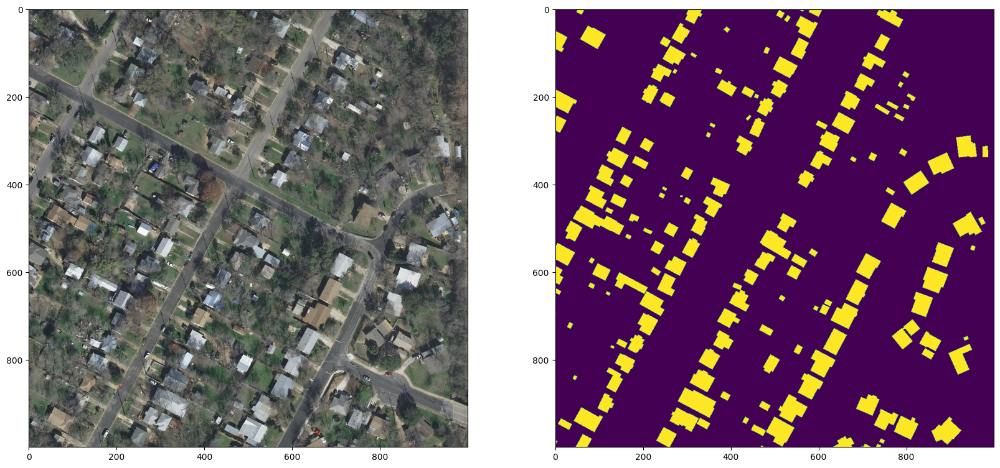

In [ ]:
image = Image.open(os.path.join(IMAGES_DIR, '13.tif'))
mask = Image.open(os.path.join(MASKS_DIR, '13.tif')).convert('L')

fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image)
axs[1].imshow(mask)
plt.show()

In [ ]:
# prepare the image for the model (aligned resize)
feature_extractor_inference = SegformerImageProcessor(do_random_crop=False, do_pad=False)

pixel_values = feature_extractor_inference(image, return_tensors="pt").pixel_values.to(device)
print(pixel_values.shape)

torch.Size([1, 3, 512, 512])


In [ ]:
model.eval()

outputs = model(pixel_values=pixel_values) # logits are of shape (batch_size, num_labels, height/4, width/4)
logits = outputs.logits.cpu()
print(logits.shape)

torch.Size([1, 2, 128, 128])


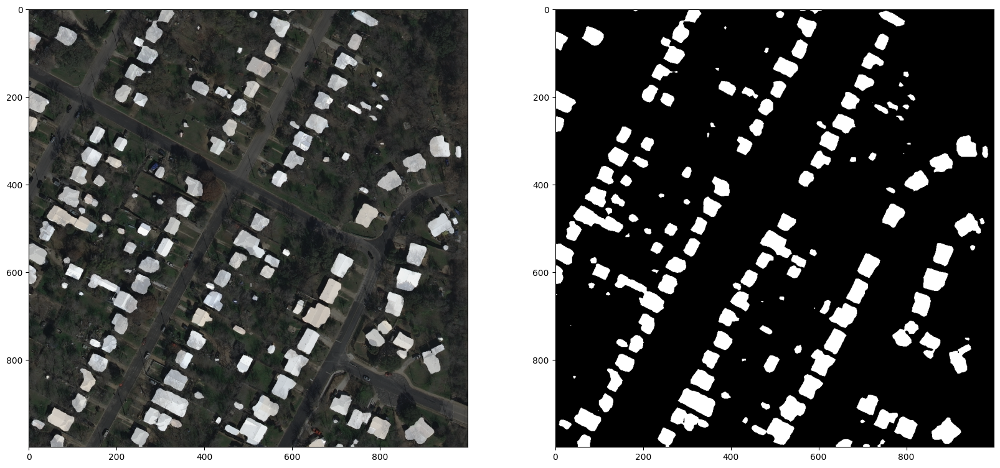

In [ ]:
# First, rescale logits to original image size
upsampled_logits = nn.functional.interpolate(logits,
                size=image.size[::-1], # (height, width)
                mode='bilinear',
                align_corners=False)

# Second, apply argmax on the class dimension
seg = upsampled_logits.argmax(dim=1)[0]
color_seg = np.zeros((seg.shape[0], seg.shape[1], 3), dtype=np.uint8) # height, width, 3\
for label, color in enumerate(palette*255):
    color_seg[seg == label, :] = color
# Convert to BGR
color_seg = color_seg[..., ::-1]

# Show image + mask
img = np.array(image) * 0.5 + color_seg * 0.5
img = img.astype(np.uint8)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(img)
axs[1].imshow(color_seg)
plt.show()

## Ejemplo 2

Se comprueba el desempeño del modelo identificando edificios con una imagen representativa del conjunto de datos Spacenet. En este caso el modelo no identifica todos los edificios, pero hace un buen papel teniendo en cuenta la dificultad de la imágen, con edificios muy pequeños y colores demasiado homogéneos.

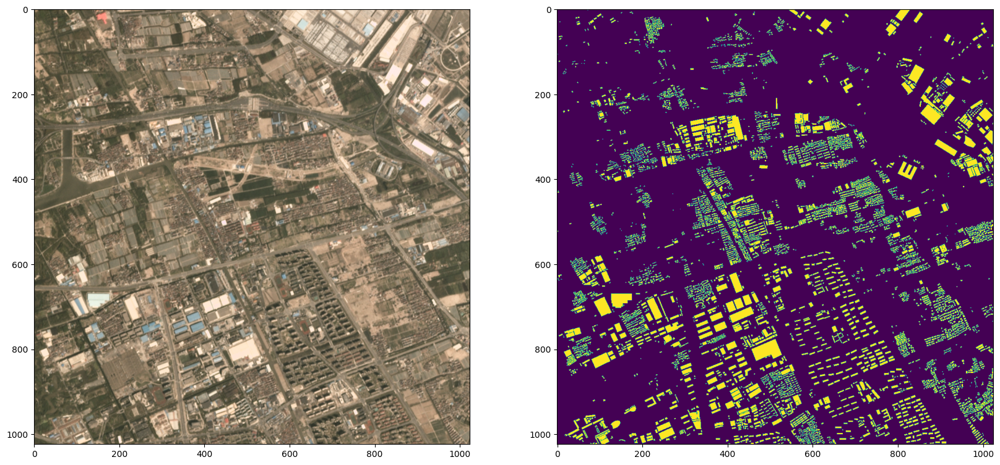

In [ ]:
image = Image.open(os.path.join(IMAGES_DIR, '5848.tif'))
mask = Image.open(os.path.join(MASKS_DIR, '5848.tif')).convert('L')

fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image)
axs[1].imshow(mask)
plt.show()

In [ ]:
# prepare the image for the model (aligned resize)
feature_extractor_inference = SegformerImageProcessor(do_random_crop=False, do_pad=False)

pixel_values = feature_extractor_inference(image, return_tensors="pt").pixel_values.to(device)
print(pixel_values.shape)

torch.Size([1, 3, 512, 512])


In [ ]:
model.eval()

outputs = model(pixel_values=pixel_values) # logits are of shape (batch_size, num_labels, height/4, width/4)
logits = outputs.logits.cpu()
print(logits.shape)

torch.Size([1, 2, 128, 128])


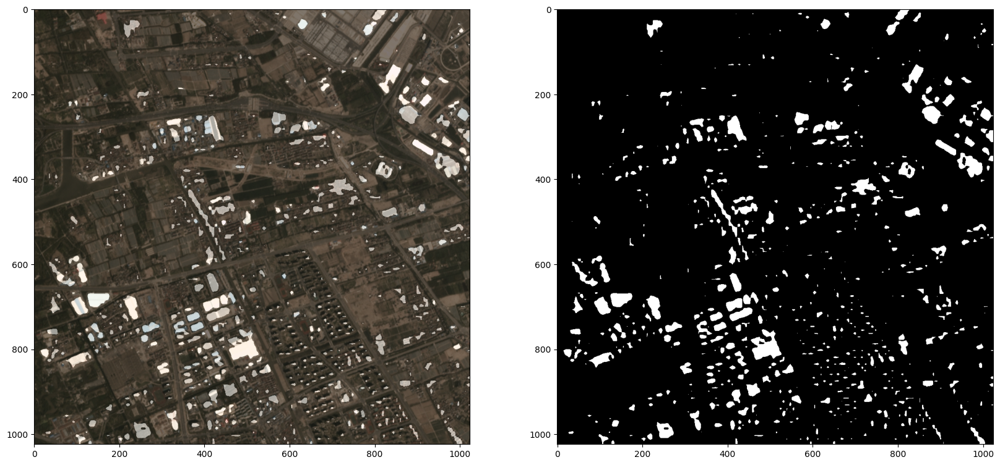

In [ ]:
# First, rescale logits to original image size
upsampled_logits = nn.functional.interpolate(logits,
                size=image.size[::-1], # (height, width)
                mode='bilinear',
                align_corners=False)

# Second, apply argmax on the class dimension
seg = upsampled_logits.argmax(dim=1)[0]
color_seg = np.zeros((seg.shape[0], seg.shape[1], 3), dtype=np.uint8) # height, width, 3\
for label, color in enumerate(palette*255):
    color_seg[seg == label, :] = color
# Convert to BGR
color_seg = color_seg[..., ::-1]

# Show image + mask
img = np.array(image) * 0.5 + color_seg * 0.5
img = img.astype(np.uint8)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(img)
axs[1].imshow(color_seg)
plt.show()